In [1]:
from IPython.display import Image

Image(url='https://img4.cityrealty.com/neo/i/p/mig/airbnb_guide.jpg')

# <font color = 'blue'> AirBnB Data Analysis with Python Final Project
    

### <font color='blue'>Content: 
We are focusing on California’s data for analysis. Being new to California, it would be interesting to learn about places which people prefer for AirBnb in California. Our main focus was around affordability, customer preference for AirBnb property based on customer reviews and how close are these AirBnb properties from airport, beach and other touristy location.

### <font color='blue'>Dataset:
https://www.kaggle.com/gkdoad/airbnb

### <font color='blue'>Team:
<ol>
<li> Resham Uttamchandani - ruttamchandani@scu.edu</li>
<li> Mukesh Ganesh - mganesh2@scu.edu</li>
<li> Pratiksha Raval - praval@scu.edu</li>
<li> Dnyanai Surkutwar - dsurkutwar@scu.edu</li>
</ol>

### <font color='blue'>Following are a few questions that we aim to answer through our analysis:
<ol>
<li>Affordability analysis: How do prices of listings vary by location?</li>
<li>Airbnb property preference based on cutomer reviews.</li>
<li>What are the different types of properties in and around LA? Do they vary by neighborhood?</li>
<li>What neighborhoods are rated highly by guests?</li>
<li>Customer preference based Airbnb recommendations.</li>  
</ol>


##### <font color='blue'> Importing libraries 

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import json
import branca

pd.set_option('display.max_columns',50)
pd.options.display.max_rows

60

##### <font color='blue'> Setting the map location co-ordinates for the map graphs later

In [3]:
# Setting a base map
lat = 34.1000
long = -118.4662

##### <font color='blue'> Read the listings csv file and setting the index column as id 

In [4]:
initFile = pd.read_csv('listings.csv',index_col= 'id',low_memory=False)
initFile.head(1)

,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,...,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
109,https://www.airbnb.com/rooms/109,20190708161040,2019-07-09,Amazing bright elegant condo park front *UPGRA...,"*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...",none,NaN,NaN,NaN,NaN,NaN,Camelot NEW RESIDENTS’ GENERAL INFORMATION F...,NaN,NaN,https://a0.muscache.com/im/pictures/4321499/1d...,NaN,521,https://www.airbnb.com/users/show/521,Paolo,2008-06-27,"San Francisco, California, United States",Search for me on the Internet with the keyword...,NaN,...,2019-07-09,2,0,2011-08-15,2016-05-15,80.0,10.0,10.0,6.0,8.0,10.0,8.0,f,NaN,"{""Culver City"","" CA""}",f,f,strict_14_with_grace_period,t,f,1,1,0,0,0.02


##### <font color='blue'> Description of Data
<ol>
<font color='blue'><li>The dataset comprises of three main tables:</li></font>
<ul>
<font color='blue'><li>listings -</li></font> Detailed listings data showing 106 atttributes for each of the listings. Some of the attributes used in the analysis are price, longitude, latitude, listing_type (categorical),neighbourhood_cleansed(categorical), ratings among others.
<font color='blue'><li>reviews -</li></font> Detailed reviews given by the guests with 6 attributes. Key attributes include review_scores_rating, review_scores_accuracy, review_scores_cleanliness, review_scores_checkin, review_scores_communication, review_scores_location, review_scores_value, cancellation_policy.
</ul>
<br>
</ol>

<font color='blue'>                          
2. A quick glance at the data shows that there are:</font>
<ul>
<li>Most of the listings in California are based in and near LA, predominately in LA county. 
<li>Over 35,959 reviews have been written by guests since 26th May 2009.</li>
<li>The price for a listing ranges from 10 per night to 25,000 dollars(!) per night. Listing with $25,000 price tag are in Hollywood hills west.</li>
</ul>

In [5]:
initFile.first_review.count()

35959

In [6]:
initFile.first_review.sort_values(ascending=True).head(1)

id
6931    2009-05-26
Name: first_review, dtype: object

In [7]:
initFile.head()

,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,...,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
109,https://www.airbnb.com/rooms/109,20190708161040,2019-07-09,Amazing bright elegant condo park front *UPGRA...,"*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...",none,NaN,NaN,NaN,NaN,NaN,Camelot NEW RESIDENTS’ GENERAL INFORMATION F...,NaN,NaN,https://a0.muscache.com/im/pictures/4321499/1d...,NaN,521,https://www.airbnb.com/users/show/521,Paolo,2008-06-27,"San Francisco, California, United States",Search for me on the Internet with the keyword...,NaN,...,2019-07-09,2,0,2011-08-15,2016-05-15,80.0,10.0,10.0,6.0,8.0,10.0,8.0,f,NaN,"{""Culver City"","" CA""}",f,f,strict_14_with_grace_period,t,f,1,1,0,0,0.02
344,https://www.airbnb.com/rooms/344,20190708161040,2019-07-09,Family perfect;Pool;Near Studios!,This home is perfect for families; aspiring ch...,"Cheerful & comfortable; near studios, amusemen...",This home is perfect for families; aspiring ch...,none,Quiet-yet-close to all the fun in LA! Hollywoo...,"One dog may be on premises, friendly and cared...",Short drive to subway and elevated trains runn...,"Pool, patio and self-contained main house all ...",Host and caretaker may be available throughout...,Host asks that guests refrain from partying lo...,NaN,NaN,https://a0.muscache.com/im/pictures/cc4b724d-d...,NaN,767,https://www.airbnb.com/users/show/767,Melissa,2008-07-11,"Burbank, California, United States","Single mother, CEO and Owner of an internation...",within a day,...,2019-07-09,6,2,2016-06-14,2018-10-21,93.0,10.0,10.0,10.0,10.0,10.0,9.0,f,NaN,NaN,t,f,flexible,f,f,1,1,0,0,0.16
2708,https://www.airbnb.com/rooms/2708,20190708161040,2019-07-09,Fireplace Mirrored Mini Suit (Website hidden b...,Our best memory foam pillows you'll ever sleep...,Flickering fireplace. Blendtec® Designer 625 ...,Our best memory foam pillows you'll ever sleep...,none,We are minutes away from the Mentor Language I...,Decorated for the Holidays. Blendtec® Designer...,There are many buses; bus stops going in every...,"Kitchen with new refrigerator, dishwasher, sto...",I am friendly and available to help you with y...,I just have one rule. The Golden Rule Do unto ...,NaN,NaN,https://a0.muscache.com/im/pictures/40618141/2...,NaN,3008,https://www.airbnb.com/users/show/3008,Chas.,2008-09-16,"Los Angeles, California, United States",Writer.\r\nLiterary Manager.\r\nPhotographer.\...,within an hour,...,2019-07-09,20,11,2014-06-09,2019-05-20,98.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,"{""City of Los Angeles"","" CA""}",t,f,strict_14_with_grace_period,f,f,2,0,2,0,0.32
2732,https://www.airbnb.com/rooms/2732,20190708161040,2019-07-09,Zen Life at the Beach,NaN,This is a three story townhouse with the follo...,This is a three story townhouse with the follo...,none,NaN,NaN,NaN,NaN,NaN,ABOUT YOU. Friendly travelers or people comin...,NaN,NaN,https://a0.muscache.com/im/pictures/1082974/0f...,NaN,3041,https://www.airbnb.com/users/show/3041,Yoga Priestess,2008-09-17,"Santa Monica, California, United States",I have been teaching yoga and m

##### <font color='blue'> Reseting the index and assigning a new column as the dataset id 

In [8]:
initFile.reset_index(inplace=True)

In [9]:
initFile['colid'] = initFile.index 

In [10]:
initFile.drop('id',axis=1,inplace=True)

In [11]:
initFile.rename(columns={'colid':'id'},inplace=True)
initFile.id +=1

In [12]:
initFile.set_index('id',inplace=True)
initFile.head(1)

,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,...,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,https://www.airbnb.com/rooms/109,20190708161040,2019-07-09,Amazing bright elegant condo park front *UPGRA...,"*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...",none,NaN,NaN,NaN,NaN,NaN,Camelot NEW RESIDENTS’ GENERAL INFORMATION F...,NaN,NaN,https://a0.muscache.com/im/pictures/4321499/1d...,NaN,521,https://www.airbnb.com/users/show/521,Paolo,2008-06-27,"San Francisco, California, United States",Search for me on the Internet with the keyword...,NaN,...,2019-07-09,2,0,2011-08-15,2016-05-15,80.0,10.0,10.0,6.0,8.0,10.0,8.0,f,NaN,"{""Culver City"","" CA""}",f,f,strict_14_with_grace_period,t,f,1,1,0,0,0.02


### Data analysis and data Cleaning:

##### <font color='blue'> Cleaning the dataset to make sure we have only CA related values

In [13]:
df_cleansed = initFile.copy()

In [14]:
### Taking only the CA listings and making sure everything in state as uppercase
df_cleansed.state.loc[df_cleansed.state=='California'] = 'CA'
df_cleansed.state.unique()
df_cleansed.state = df_cleansed['state'].str.upper()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [15]:
## As we can see there are some unwanted & non-CA entries in the state column
df_cleansed.state.value_counts()

CA    44611
加州        2
NY        2
IL        1
FL        1
加洲        1
Name: state, dtype: int64

##### <font color = 'blue'> We need to remove the non-CA values from the dataset

In [16]:
df_cleansed.drop(df_cleansed[~(df_cleansed.state.values=='CA')].index,axis=0,inplace=True)

##### <font color='blue'> Convert the city column to lower case

In [17]:
df_cleansed.city = df_cleansed.city.str.lower()
df_cleansed.city.unique()
df_cleansed.city.dropna(inplace=True)

##### <font color='blue'> Cleaning the city column and dropping NaN values in city column 

In [18]:
df_cleansed['city'] = df_cleansed['city'].str.replace(r'[^\x00-\x7F]+', '')
df_cleansed.city.dropna(inplace=True)
df_cleansed.city.value_counts()

los angeles                                27933
long beach                                  1612
santa monica                                1059
west hollywood                               973
beverly hills                                767
                                           ...  
los angeles, noho art district                 1
woodland hls                                   1
san fernando valley                            1
north hollywood los angeles studio city        1
rowland heigh                                  1
Name: city, Length: 334, dtype: int64

In [19]:
df_cleansed.groupby('city')['neighbourhood_cleansed'].value_counts()

city                         neighbourhood_cleansed   
                             Rowland Heights              5
                             Monterey Park                2
                             El Monte                     1
                             Hacienda Heights             1
                             Rosemead                     1
                                                         ..
woodland hills, los angeles  Woodland Hills               1
woodland hills/los angeles   Woodland Hills               1
woodland hls                 Woodland Hills               1
wrightwood                   Angeles Crest                2
                             Southeast Antelope Valley    1
Name: neighbourhood_cleansed, Length: 857, dtype: int64

In [20]:
df_cleansed.smart_location.shape

(44611,)

In [21]:
df_cleansed.smart_location = df_cleansed.smart_location.str.lower()

In [22]:
df_cleansed.isnull().sum()

listing_url                                        0
scrape_id                                          0
last_scraped                                       0
name                                               6
summary                                         1787
                                                ... 
calculated_host_listings_count                     0
calculated_host_listings_count_entire_homes        0
calculated_host_listings_count_private_rooms       0
calculated_host_listings_count_shared_rooms        0
reviews_per_month                               8658
Length: 105, dtype: int64

##### <font color='blue'> Cleaning the smart_location column, removing the non-English characters in the smart_location column 

In [23]:
df_cleansed.drop(df_cleansed[(df_cleansed['smart_location'] == '蒙特利帕克, ca') | \
                       (df_cleansed['smart_location'] == '因達斯特里, ca') | \
                       (df_cleansed['smart_location'] == '艾尔蒙地, ca') | \
                       (df_cleansed['smart_location'] == '沃尔纳特, ca') | \
                       (df_cleansed['smart_location'] == '哈仙达岗, ca') | \
                       (df_cleansed['smart_location'] == '罗兰高地, ca') | \
                       (df_cleansed['smart_location'] == '罗兰岗, ca') | \
                       (df_cleansed['smart_location'] == '天普市, ca') | \
                       (df_cleansed['smart_location'] == '洛杉矶, ca')  \
                      ].index, inplace = True)

##### <font color='blue'> Replacing ', ca' in smart_location column so that it is uniform with the other location related columns 

In [24]:
df_cleansed.smart_location = df_cleansed.smart_location.str.replace(', ca',' ', regex=True)
df_cleansed.smart_location = df_cleansed.smart_location.str.strip()
## Removing the spaces from the neighbourhood_cleansed
df_cleansed.neighbourhood_cleansed = df_cleansed.neighbourhood_cleansed.str.strip()

In [25]:
## Convert smart_location and neighbourhood_cleansed columns into lower case
df_cleansed.smart_location = df_cleansed.smart_location.str.lower()
df_cleansed.neighbourhood_cleansed = df_cleansed.neighbourhood_cleansed.str.lower() 
df_cleansed.head(2)

,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,...,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,https://www.airbnb.com/rooms/109,20190708161040,2019-07-09,Amazing bright elegant condo park front *UPGRA...,"*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...","*** Unit upgraded with new bamboo flooring, br...",none,NaN,NaN,NaN,NaN,NaN,Camelot NEW RESIDENTS’ GENERAL INFORMATION F...,NaN,NaN,https://a0.muscache.com/im/pictures/4321499/1d...,NaN,521,https://www.airbnb.com/users/show/521,Paolo,2008-06-27,"San Francisco, California, United States",Search for me on the Internet with the keyword...,NaN,...,2019-07-09,2,0,2011-08-15,2016-05-15,80.0,10.0,10.0,6.0,8.0,10.0,8.0,f,NaN,"{""Culver City"","" CA""}",f,f,strict_14_with_grace_period,t,f,1,1,0,0,0.02
2,https://www.airbnb.com/rooms/344,20190708161040,2019-07-09,Family perfect;Pool;Near Studios!,This home is perfect for families; aspiring ch...,"Cheerful & comfortable; near studios, amusemen...",This home is perfect for families; aspiring ch...,none,Quiet-yet-close to all the fun in LA! Hollywoo...,"One dog may be on premises, friendly and cared...",Short drive to subway and elevated trains runn...,"Pool, patio and self-contained main house all ...",Host and caretaker may be available throughout...,Host asks that guests refrain from partying lo...,NaN,NaN,https://a0.muscache.com/im/pictures/cc4b724d-d...,NaN,767,https://www.airbnb.com/users/show/767,Melissa,2008-07-11,"Burbank, California, United States","Single mother, CEO and Owner of an internation...",within a day,...,2019-07-09,6,2,2016-06-14,2018-10-21,93.0,10.0,10.0,10.0,10.0,10.0,9.0,f,NaN,NaN,t,f,flexible,f,f,1,1,0,0,0.16


### <font color='Red'><b> Interesting Fact 1</b></font>

#### <font color='green'>Q) Make a dataset copy for Interesting Fact 1 which is focused on:
<font color='green'>Affordability analysis: How do prices of listings vary by location</font><br>

##### <div class="alert alert-block alert-success">Fact 1 insights:<br><li>For the Low price range,almost all of the prices in Low price range are located in Hollywood.<br>Other top locations with maximum low price range are: Venice, pico-union, Downtown and Long Beach.<br>The average price in the Low range is around 100 dollars.</li><br><li>For the Mid price range,almost all of the prices in the Mid price range are located in Venice.<br>Other top locations with maximum mid price range are: Hollywood, Downtown and Long Beach.<br>The average price in the Mid range is around 150-200 dollars.</li><br><li>As observed above,Almost all of the prices in the High price range are located in Venice and Beverly grove.Venice seems a real versatile location for Airbnb listings.<br>Other top locations with maximum high price range are: Hollywood hills West, Malibu and Avalon.<br>The average price in the High range is around $550-800.</li></div>

In [26]:
df_Fact1 = df_cleansed[['price','security_deposit','cleaning_fee','guests_included','extra_people','minimum_nights',\
          'maximum_nights','amenities','neighbourhood_cleansed',\
       'state','zipcode','latitude','longitude']].copy()
## Renaming the neighbourhood_cleansed column to location 
df_Fact1.rename(columns={'neighbourhood_cleansed':'location'},inplace=True)

In [27]:
df_Fact1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 44599 entries, 1 to 44620
Data columns (total 13 columns):
price               44599 non-null object
security_deposit    33821 non-null object
cleaning_fee        38680 non-null object
guests_included     44599 non-null int64
extra_people        44599 non-null object
minimum_nights      44599 non-null int64
maximum_nights      44599 non-null int64
amenities           44599 non-null object
location            44599 non-null object
state               44599 non-null object
zipcode             44058 non-null object
latitude            44599 non-null float64
longitude           44599 non-null float64
dtypes: float64(2), int64(3), object(8)
memory usage: 4.8+ MB


In [28]:
df_Fact1.isna().sum()
## We see that we have NaN values in the security_deposit, cleaning_fee, zipcode columns 
## So, lets clean these columns 

price                   0
security_deposit    10778
cleaning_fee         5919
guests_included         0
extra_people            0
minimum_nights          0
maximum_nights          0
amenities               0
location                0
state                   0
zipcode               541
latitude                0
longitude               0
dtype: int64

In [29]:
## Lets see what the amenities column holds..
df_Fact1.groupby('amenities')['price'].value_counts().nlargest(3)

amenities                                                                                                                                                                                                                                                                          price 
{Wifi,"Air conditioning",Kitchen,Heating,Washer,Dryer,"Smoke detector","Carbon monoxide detector","First aid kit","Fire extinguisher",Essentials,Shampoo,"Hair dryer"}                                                                                                             $15.00    22
{Wifi,Kitchen,Heating,"Smoke detector","First aid kit","Fire extinguisher",Essentials,"Hair dryer","Laptop friendly workspace","Hot water","Bed linens",Microwave,"Dishes and silverware",Oven,Stove,"Long term stays allowed"}                                                    $23.00    21
{Internet,Wifi,"Air conditioning",Kitchen,"Free parking on premises",Breakfast,"Free street parking",Heating,Washer,Dryer,"Smoke detector","Fi

##### <font color='blue'> Cleaning the Amenities column and converting it to lower case

In [30]:
df_Fact1.amenities = df_Fact1.amenities.str.strip('{}')
df_Fact1.amenities = df_Fact1.amenities.str.replace('"','')
df_Fact1.amenities = df_Fact1.amenities.str.lower()

##### <font color='blue'> Trying to understand which are the more frequently used values in the amenities column 

In [31]:
pd.Series(' '.join(df_Fact1['amenities']).lower().split(',')).value_counts().nlargest(12)

essentials                  41874
smoke detector              41056
kitchen                     39511
heating                     39426
hangers                     37406
wifi                        37090
shampoo                     35286
carbon monoxide detector    34568
air conditioning            33841
washer                      33837
hair dryer                  33685
dryer                       33251
dtype: int64

##### <font color='blue'> Creating new coulmns around most frequently used values in the Amenities column 

In [32]:
## Taking the most sort after amenities by customers and creating new columns for them 
df_Fact1['wifi'] = ''
df_Fact1['ac'] = ''
df_Fact1['pet'] = ''
df_Fact1['park'] = ''
df_Fact1['htub'] = ''
df_Fact1['dishwasher'] = ''
df_Fact1['bbq'] = ''
df_Fact1['pool'] = ''
df_Fact1['hr'] = ''
df_Fact1['coffee'] = ''
df_Fact1['heating'] = ''
df_Fact1['iron'] = ''
df_Fact1['washer'] = ''
df_Fact1['dryer'] = ''
df_Fact1['parking'] = ''

##### <font color='blue'> If the amenities satisfy the condition of being present in the Amenities column then set the column as 'True'

In [33]:
df_Fact1.wifi = df_Fact1.amenities.str.contains("wifi").apply(lambda x: 'wifi' if x==True else '')
df_Fact1.ac = df_Fact1.amenities.str.contains("air conditioning").apply(lambda x: 'air conditioning' if x==True else '')
df_Fact1.pet = df_Fact1.amenities.str.contains("pet").apply(lambda x: 'pet' if x==True else '')
df_Fact1.park = df_Fact1.amenities.str.contains("park").apply(lambda x: 'park' if x==True else '')
df_Fact1.htub = df_Fact1.amenities.str.contains("hot tub").apply(lambda x: 'hot tub' if x==True else '')
df_Fact1.dishwasher = df_Fact1.amenities.str.contains("dishwasher").apply(lambda x: 'dishwasher' if x==True else '')
df_Fact1.bbq = df_Fact1.amenities.str.contains("bbq").apply(lambda x: 'BBQ' if x==True else '')
df_Fact1.pool = df_Fact1.amenities.str.contains("pool").apply(lambda x: 'pool' if x==True else '')
df_Fact1.hr = df_Fact1.amenities.str.contains("24-hour check-in").apply(lambda x: '24-hour check-in' if x==True else '')
df_Fact1.coffee = df_Fact1.amenities.str.contains("coffee").apply(lambda x: 'coffee' if x==True else '')
df_Fact1.heating = df_Fact1.amenities.str.contains("heating").apply(lambda x: 'heating' if x==True else '')
df_Fact1.iron = df_Fact1.amenities.str.contains("iron").apply(lambda x: 'iron' if x==True else '')
df_Fact1.washer = df_Fact1.amenities.str.contains("washer").apply(lambda x: 'washer' if x==True else '')
df_Fact1.dryer = df_Fact1.amenities.str.contains("dryer").apply(lambda x: 'dryer' if x==True else '')
df_Fact1.parking = df_Fact1.amenities.str.contains("parking").apply(lambda x: 'parking' if x==True else '')

##### <font color='blue'> Drop the old amenities column as we have made columns for amenities and did one-hot encoding

In [34]:
df_Fact1.drop('amenities',axis=1,inplace=True)

##### <font color='blue'> Adding amenities to the Amenities column 

In [35]:
df_Fact1['amenities'] = df_Fact1.wifi+' '+df_Fact1.ac+' '+df_Fact1.pet+' '+df_Fact1.park+' '+\
df_Fact1.htub+' '+df_Fact1.dishwasher+' '+df_Fact1.bbq+' '+df_Fact1.pool+' '+df_Fact1.hr+' '+df_Fact1.coffee+' '+\
df_Fact1.heating+' '+df_Fact1.iron+' '+df_Fact1.washer+' '+df_Fact1.dryer+' '+df_Fact1.parking


##### <font color='blue'> Converting the individual amenities columns using one-hot encoding 

In [36]:
df_Fact1.wifi = df_Fact1.wifi.apply(lambda x: 1 if x=='wifi' else 0)
df_Fact1.ac = df_Fact1.ac.apply(lambda x: 1 if x=='air conditioning' else 0)
df_Fact1.pet = df_Fact1.pet.apply(lambda x: 1 if x=='pet' else 0)
df_Fact1.park = df_Fact1.park.apply(lambda x:1 if x=='park' else 0)
df_Fact1.htub = df_Fact1.htub.apply(lambda x:1 if x=='hot tub' else 0)
df_Fact1.dishwasher = df_Fact1.dishwasher.apply(lambda x:1 if x=='dishwasher' else 0)
df_Fact1.bbq = df_Fact1.bbq.apply(lambda x:1 if x=='BBQ' else 0)
df_Fact1.pool = df_Fact1.pool.apply(lambda x:1 if x=='pool' else 0)
df_Fact1.hr = df_Fact1.hr.apply(lambda x:1 if x=='24-hour check-in' else 0)
df_Fact1.coffee = df_Fact1.coffee.apply(lambda x:1 if x=='coffee' else 0)
df_Fact1.heating = df_Fact1.heating.apply(lambda x:1 if x=='heating' else 0)
df_Fact1.iron = df_Fact1.iron.apply(lambda x:1 if x=='iron' else 0)
df_Fact1.washer = df_Fact1.washer.apply(lambda x:1 if x=='washer' else 0)
df_Fact1.dryer = df_Fact1.dryer.apply(lambda x:1 if x=='dryer' else 0)
df_Fact1.parking = df_Fact1.parking.apply(lambda x:1 if x=='parking' else 0)

In [37]:
df_Fact1.isna().sum()

price                   0
security_deposit    10778
cleaning_fee         5919
guests_included         0
extra_people            0
minimum_nights          0
maximum_nights          0
location                0
state                   0
zipcode               541
latitude                0
longitude               0
wifi                    0
ac                      0
pet                     0
park                    0
htub                    0
dishwasher              0
bbq                     0
pool                    0
hr                      0
coffee                  0
heating                 0
iron                    0
washer                  0
dryer                   0
parking                 0
amenities               0
dtype: int64

##### <font color='blue'> Working on the security_deposit column and adjusting its NaN values

In [38]:
## Removing the '$' & ',' symbols form the security_deposit column 
df_Fact1.security_deposit = df_Fact1.security_deposit.str.strip('$')
df_Fact1.security_deposit = df_Fact1.security_deposit.str.replace(',','')

In [39]:
## Converting the security_deposit column to Float from str
df_Fact1.security_deposit = df_Fact1.security_deposit.astype('float64')

In [40]:
## Understanding the security_deposit column using describe()
df_Fact1.security_deposit.describe()

count     33821.000000
mean        435.482008
std        2283.420823
min           0.000000
25%           0.000000
50%         200.000000
75%         450.000000
max      250000.000000
Name: security_deposit, dtype: float64

In [41]:
## Rounding the security_deposit column values after filling the NaN values to mean() of
## the security_deposit values
df_Fact1.security_deposit.fillna(round(df_Fact1.security_deposit.mean(),2),inplace=True)

##### <font color='blue'> Working on the cleaning_fee column and adjusting its NaN values

In [42]:
## Understanding the cleaning_fee column using describe()
df_Fact1.cleaning_fee.describe()

count      38680
unique       301
top       $50.00
freq        2977
Name: cleaning_fee, dtype: object

In [43]:
df_Fact1.cleaning_fee.isna().sum()

5919

In [44]:
## Removing the '$' & ',' symbols form the cleaning_fee column 
df_Fact1.cleaning_fee = df_Fact1.cleaning_fee.str.strip('$')
df_Fact1.cleaning_fee = df_Fact1.cleaning_fee.str.replace(',','')

In [45]:
## Converting the cleaning_fee column to Float from str
df_Fact1.cleaning_fee = df_Fact1.cleaning_fee.astype('float64')

In [46]:
## Understanding the cleaning_fee column using describe()
df_Fact1.cleaning_fee.describe()

count    38680.000000
mean        87.038573
std         93.339460
min          0.000000
25%         30.000000
50%         65.000000
75%        100.000000
max       2500.000000
Name: cleaning_fee, dtype: float64

In [47]:
## Converting the cleaning_fee column NaN values to the mean() of values in that column
df_Fact1.cleaning_fee.fillna(round(df_Fact1.cleaning_fee.mean(),2),inplace=True)

In [48]:
## Describing the cleaning_fee column after filling the NaN values in the column
df_Fact1.cleaning_fee.describe()

count    44599.000000
mean        87.038762
std         86.925103
min          0.000000
25%         35.000000
50%         75.000000
75%        100.000000
max       2500.000000
Name: cleaning_fee, dtype: float64

In [49]:
df_Fact1.isna().sum()

price                 0
security_deposit      0
cleaning_fee          0
guests_included       0
extra_people          0
minimum_nights        0
maximum_nights        0
location              0
state                 0
zipcode             541
latitude              0
longitude             0
wifi                  0
ac                    0
pet                   0
park                  0
htub                  0
dishwasher            0
bbq                   0
pool                  0
hr                    0
coffee                0
heating               0
iron                  0
washer                0
dryer                 0
parking               0
amenities             0
dtype: int64

##### <font color='blue'> Checking the zipcode column and its NaN values

In [50]:
df_Fact1.zipcode.isna().sum()

541

In [51]:
df_Fact1.zipcode.dropna(inplace=True)

In [52]:
df_Fact1.shape

(44599, 28)

##### <font color='blue'> Checking the price column

In [53]:
## Removing the '$' & ',' symbols form the price column 
df_Fact1.price = df_Fact1.price.str.strip('$')
df_Fact1.price = df_Fact1.price.str.replace(',','')

In [54]:
## Converting the price column to Float from str
df_Fact1.price = df_Fact1.price.astype('float64')

In [55]:
## Understanding the price column using describe()
df_Fact1.price.describe()

count    44599.000000
mean       211.903249
std        579.067382
min          0.000000
25%         70.000000
50%        110.000000
75%        186.000000
max      25000.000000
Name: price, dtype: float64

In [56]:
## Price '0' makes no sense as the listing need to charge for per night stay and there are
## only 9 values 
df_Fact1.drop(df_Fact1[df_Fact1.price==0].index,axis=0,inplace=True)

In [57]:
df_Fact1.price.count()

44590

##### <font color='blue'> Checking the extra_people column and making it numerical 

In [58]:
## Removing the '$' & ',' symbols form the extra_people column 
df_Fact1.extra_people = df_Fact1.extra_people.str.strip('$')
df_Fact1.extra_people = df_Fact1.extra_people.str.replace(',','')

In [59]:
## Converting the extra_people column to Float from str
df_Fact1.extra_people = df_Fact1.extra_people.astype('float64')

In [60]:
## Understanding the extra_people column using describe()
df_Fact1.extra_people.describe()

count    44590.000000
mean        15.657547
std         26.988920
min          0.000000
25%          0.000000
50%         10.000000
75%         24.000000
max        300.000000
Name: extra_people, dtype: float64

In [61]:
df_Fact1.guests_included.dtype
df_Fact1.minimum_nights.dtype
df_Fact1.maximum_nights.dtype
## Since the numerical columns are alreay in integer type we do not need to make any change

dtype('int64')

##### <font color='blue'> Dividing the price column into 10 equal parts 

In [62]:
pd.qcut(df_Fact1.price,10)

id
1          (110.0, 130.0]
2          (160.0, 209.0]
3            (62.0, 79.0]
4          (130.0, 160.0]
5            (79.0, 95.0]
               ...       
44616        (46.0, 62.0]
44617        (46.0, 62.0]
44618    (349.0, 25000.0]
44619       (95.0, 110.0]
44620        (62.0, 79.0]
Name: price, Length: 44590, dtype: category
Categories (10, interval[float64]): [(9.999, 46.0] < (46.0, 62.0] < (62.0, 79.0] < (79.0, 95.0] ... (130.0, 160.0] < (160.0, 209.0] < (209.0, 349.0] < (349.0, 25000.0]]

##### <font color='blue'> Create a new priceType column which will be have price ranges - Low,Mid,High

In [63]:
df_Fact1['priceType'] = ''

##### <font color='blue'> Dividing the price column into categories and assigning them a label in the priceType column  

In [64]:
df_Fact1.priceType.loc[(df_Fact1['price']> 9.999) & (df_Fact1['price'] <= 110.0)] = 'Low'#Low
df_Fact1.priceType.loc[(df_Fact1['price'] > 110.0) & (df_Fact1['price'] <= 500.0)] = 'Mid'#Mid
df_Fact1.priceType.loc[(df_Fact1['price'] > 500.0) & (df_Fact1['price'] <= 25000.0)] = 'High'#High

##### <font color='blue'> We have created labels based on the Airbnb prices, lets have a look at the airbnb in these particular ranges

In [65]:
df_Fact1.head(1)

,price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,location,state,zipcode,latitude,longitude,wifi,ac,pet,park,htub,dishwasher,bbq,pool,hr,coffee,heating,iron,washer,dryer,parking,amenities,priceType
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,122.0,500.0,240.0,3,25.0,30,730,culver city,CA,90230,33.98209,-118.38494,1,1,1,1,1,0,0,1,1,0,1,1,1,1,1,wifi air conditioning pet park hot tub pool ...,Mid


##### <font color='blue'> First, we will check for the Low range Airbnb's

In [66]:
## Making a lowRange dataframe which has all the values with the priceType as "Low"
lowRnge = pd.DataFrame(df_Fact1[df_Fact1.priceType=='Low'])
lowRnge.head(2)

,price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,location,state,zipcode,latitude,longitude,wifi,ac,pet,park,htub,dishwasher,bbq,pool,hr,coffee,heating,iron,washer,dryer,parking,amenities,priceType
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
3,79.0,480.0,89.0,1,0.0,28,366,hollywood,CA,90046,34.09768,-118.34602,1,1,0,1,1,1,0,0,1,1,1,1,1,1,1,wifi air conditioning park hot tub dishwasher...,Low
5,80.0,100.0,75.0,1,25.0,2,730,bellflower,CA,90706,33.87619,-118.11397,1,1,0,1,1,0,0,0,0,0,1,0,1,1,1,wifi air conditioning park hot tub heati...,Low


##### <font color='blue'>Making the map for representing the Low ranged Airbnb listings using folium library 

In [67]:
## Importing the markercluster module from the folium library 
from folium.plugins import MarkerCluster
mc = MarkerCluster()

## Assigning base_low to save the map
### making the world map to zoom on the latitude and longitude of LA county as maximum 
### number of airbnb listings are in LA county.
base_low = folium.Map(location=[lowRnge.latitude.mean(), 
 lowRnge.longitude.mean()], 
 zoom_start=10)##This simply zoom in on the CA state

## For every value in the Low range airbnb's put a popup marker with the Airbnb per night
## prices
for row in lowRnge.itertuples():
    mc.add_child(folium.Marker(location=[row.latitude, row.longitude],popup=row.price))
    
base_low.add_child(mc)    

## Saving the map in html format in the current directory with the name map_lowprices
base_low.save('map_lowprices.html')

##### <div class="alert alert-block alert-danger"> Please note, you might have to run the jupyter notebook to see the map below or refer to the map_<name>.html for map details 

In [68]:
base_low

##### <font color='blue'>Now, lets see what kind of rates are included in the price ranges - Low,Mid,High for the top  places in these categories

##### <font color='blue'> Checking the Low price range closely to see what kind of prices in the Low range 

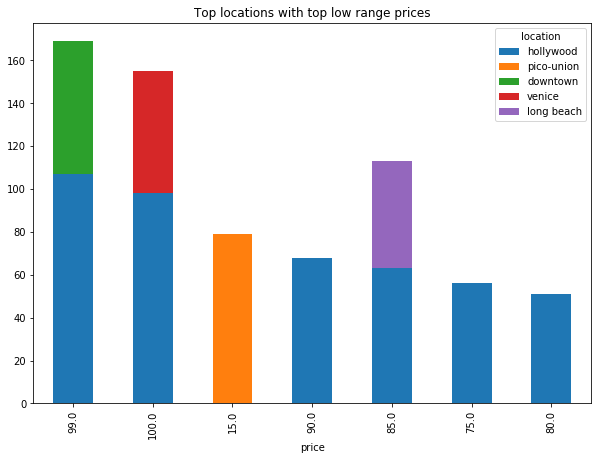

In [69]:
## Checking the low prices in the Low range for the top 10 places 
low_1 = df_Fact1[df_Fact1.priceType=='Low'].groupby(['price'])['location'].\
value_counts().nlargest(10).unstack().plot(kind='bar',stacked=True,figsize=(10,7));
plt.title('Top locations with top low range prices')
plt.show()
## Almost all the top 10 prices are in the locations below 

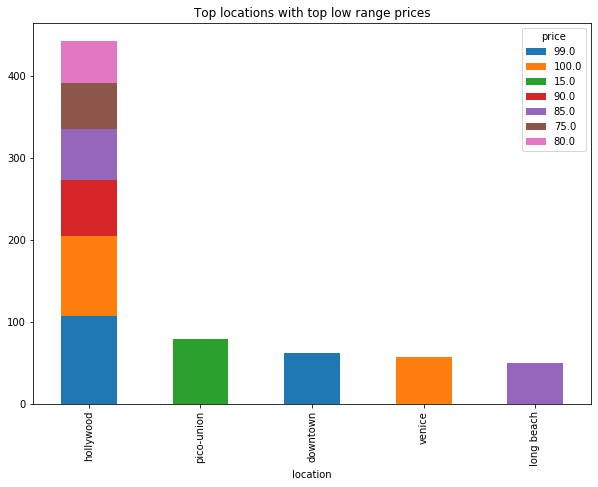

In [71]:
## Checking the low prices in the Low range for the top 10 places 
low_2 = df_Fact1[df_Fact1.priceType=='Low'].groupby(['location'])['price'].\
value_counts().nlargest(10).unstack().plot(kind='bar',stacked=True,figsize=(10,7));
plt.title('Top locations with top low range prices')
plt.show()
## Almost all the top 10 prices are in the locations below 

##### <div class="alert alert-block alert-info">As observed above,Almost all of the prices in Low price range are located in Hollywood.<br>Other top locations with maximum low price range are: Venice, pico-union, Downtown and Long Beach.<br>The average price in the Low range is around $100   
</div> 

##### <font color='blue'> Checking the Mid price range closely to see what kind of prices in the Mid range 

In [72]:
## Making a midRange dataframe which has all the values with the priceType as "Mid"
midRnge = pd.DataFrame(df_Fact1[df_Fact1.priceType=='Mid'])
midRnge.head(2)

,price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,location,state,zipcode,latitude,longitude,wifi,ac,pet,park,htub,dishwasher,bbq,pool,hr,coffee,heating,iron,washer,dryer,parking,amenities,priceType
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,122.0,500.0,240.0,3,25.0,30,730,culver city,CA,90230,33.98209,-118.38494,1,1,1,1,1,0,0,1,1,0,1,1,1,1,1,wifi air conditioning pet park hot tub pool ...,Mid
2,168.0,0.0,100.0,6,0.0,2,14,burbank,CA,91505,34.16562,-118.33458,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,wifi air conditioning pet park dishwasher BBQ...,Mid


In [73]:
## Importing the markercluster module from the folium library 
mc = MarkerCluster()

## Assigning base_mid to save the map
### making the world map to zoom on the latitude and longitude of LA county as maximum 
### number of airbnb listings are in LA county.
base_mid = folium.Map(location=[midRnge.latitude.mean(), 
 midRnge.longitude.mean()], 
 zoom_start=10)##This simply zoom in on the CA state

## For every value in the Mid range airbnb's put a popup marker with the Airbnb per night
## prices
for row in midRnge.itertuples():
    mc.add_child(folium.Marker(location=[row.latitude, row.longitude],popup=row.price))

base_mid.add_child(mc)    
## Saving the map in html format in the current directory with the name map_midprices
base_mid.save('map_midprices.html')

##### <div class="alert alert-block alert-danger"> Please note, you might have to run the jupyter notebook to see the map below or refer to the map_<name>.html for map details 

In [74]:
base_mid

##### <font color='blue'> Second, lets have a closer look into the mid range rates...

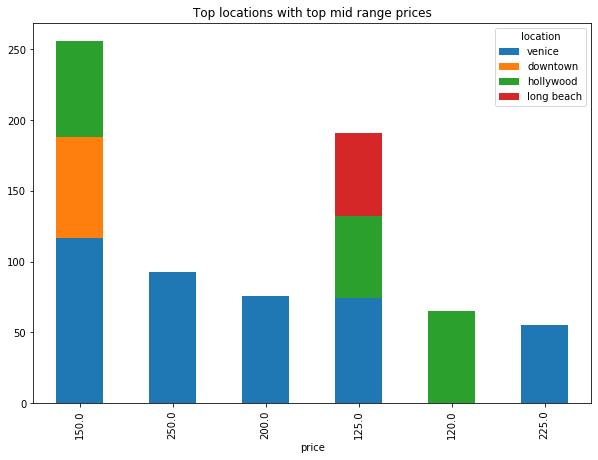

In [75]:
## Checking the mid prices in the Mid range for the top 10 places 
mid_1 = df_Fact1[df_Fact1.priceType=='Mid'].groupby(['price'])['location'].\
value_counts().nlargest(10).unstack().plot(kind='bar',stacked=True,figsize=(10,7));
plt.title('Top locations with top mid range prices')
plt.show()
## Almost all the top 10 prices are in the locations below 

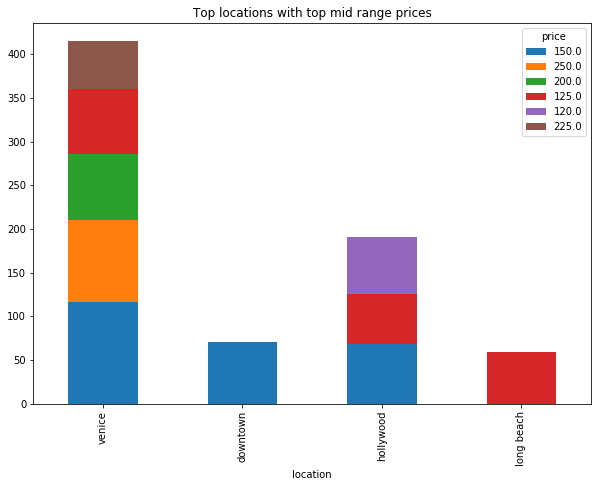

In [76]:
## Checking the mid prices in the Mid range for the top 10 places 
mid_2 = df_Fact1[df_Fact1.priceType=='Mid'].groupby(['location'])['price'].\
value_counts().nlargest(10).unstack().plot(kind='bar',stacked=True,figsize=(10,7));
plt.title('Top locations with top mid range prices')
plt.show()
## Almost all the top 10 prices are in the locations below 


##### <div class="alert alert-block alert-info">As observed above,Almost all of the prices in the Mid price range are located in Venice.<br>Other top locations with maximum mid price range are: Hollywood, Downtown and Long Beach.<br>The average price in the Mid range is around $150-200   
</div> 

In [77]:
## Making a highRange dataframe which has all the values with the priceType as "High"
highRnge = pd.DataFrame(df_Fact1[df_Fact1.priceType=='High'])
highRnge.head(2)

,price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,location,state,zipcode,latitude,longitude,wifi,ac,pet,park,htub,dishwasher,bbq,pool,hr,coffee,heating,iron,washer,dryer,parking,amenities,priceType
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
67,900.0,3000.0,400.0,1,0.0,31,1125,santa monica,CA,90401,34.00906,-118.49282,1,1,1,1,1,0,0,0,0,0,1,1,1,1,1,wifi air conditioning pet park hot tub he...,High
111,600.0,2500.0,200.0,4,25.0,4,730,venice,CA,90291,33.99201,-118.46990,1,1,0,1,0,0,0,0,0,1,1,1,1,1,1,wifi air conditioning park coffee heatin...,High


In [78]:
## Importing the markercluster module from the folium library 
mc = MarkerCluster()

## Assigning base_high to save the map
### making the world map to zoom on the latitude and longitude of LA county as maximum 
### number of airbnb listings are in LA county.
base_high = folium.Map(location=[highRnge.latitude.mean(), 
 highRnge.longitude.mean()], 
 zoom_start=10)##This simply zoom in on the CA state

## For every value in the High range airbnb's put a popup marker with the Airbnb per night
## prices
for row in highRnge.itertuples():
    mc.add_child(folium.Marker(location=[row.latitude,  row.longitude],popup=row.price))
    
base_high.add_child(mc)    
## Saving the map in html format in the current directory with the name map_highprices
base_high.save('map_highprices.html')

##### <div class="alert alert-block alert-danger"> Please note, you might have to run the jupyter notebook to see the map below or refer to the map_<name>.html for map details 

In [79]:
base_high

##### <font color='blue'>Now, lets have a closer look into the high range rates...

In [80]:
## Finding out which listing has the highest price per night!
high_info = df_Fact1[df_Fact1.priceType=='High']
high_info.location[high_info['price']==25000]

id
17480    hollywood hills west
Name: location, dtype: object

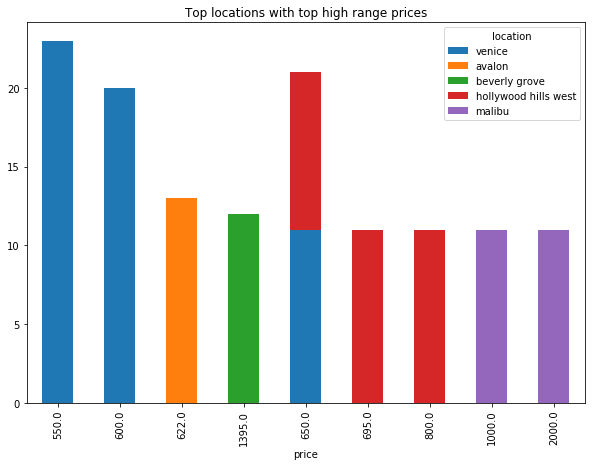

In [81]:
## Checking the high prices in the High range for the top 10 places 
high_1 = df_Fact1[df_Fact1.priceType=='High'].groupby(['price'])['location'].\
value_counts().nlargest(10).unstack().plot(kind='bar',stacked=True,figsize=(10,7));
plt.title('Top locations with top high range prices')
plt.show()
## Almost all the top 10 prices are in the locations below 

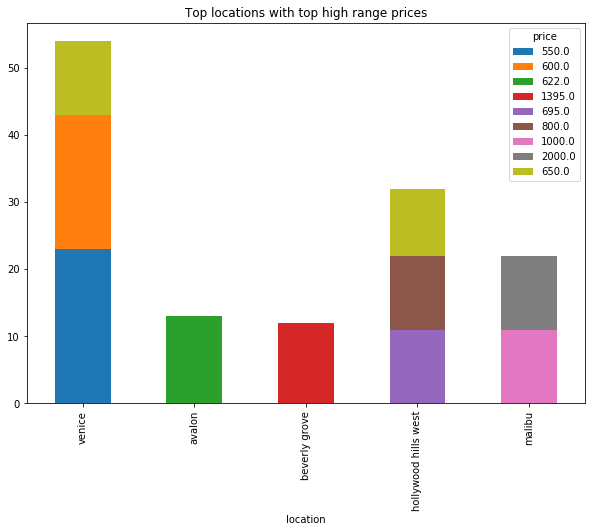

In [82]:
## Checking the high prices in the High range for the top 10 places 
high_1 = df_Fact1[df_Fact1.priceType=='High'].groupby(['location'])['price'].\
value_counts().nlargest(10).unstack().plot(kind='bar',stacked=True,figsize=(10,7));
plt.title('Top locations with top high range prices')
plt.show()
## Almost all the top 10 prices are in the locations below 

##### <div class="alert alert-block alert-info">As observed above,Almost all of the prices in the High price range are located in Venice and Beverly grove.Venice seems a real versatile location for Airbnb listings.<br>Other top locations with maximum high price range are: Hollywood hills West, Malibu and Avalon.<br>The average price in the High range is around $550-800   
</div> 

### <font color='red'><b>Interesting Fact 2</b></font>

#### <font color='green'>Q) Make a dataset copy for Interesting Fact 2 which is focused on:
<font color='green'>1) What are the different types of properties in and around LA? Do they vary by neighborhood?<br>2) Airbnb property preference based on cutomer reviews.<br>3) What neighbhourhoods are rated highly by guests?</font>

##### <div class="alert alert-block alert-success"><li>Most popular room type in the Airbnb listings is "Entire House/apt" which meaning mostly all of the customers prefer to book entire house or apartment when they select an Airbnb.The second most preferred is the "Private room" type which means that the room is private but the house or apartment is not available to only one customer group.The least popular is the "Shared room" type of Airbnb in which the customers may share the House or apartment with the host or other people already living at the Airbnb.<br><br></li><li>The top 5 neighbhourhoods according to properties and customer reviews  are:Venice,Downtown, Hollywood, Santa Monica and Long Beach.<br><br><li>We can see that Apartment style listings are highest in number in all the neighbhourhoods.As we can see, Hollywood has the highest number of apartment style listings. In Venice, we observe that both Apartment and House styled listings are highest. In Downtown we also observe that Other type of listings like tent, camper/RV etc are popular.<br><br></li><li>We see that for a perfect score of 10.0 in the categories- accuracy,cleanliness,checkin,communication,location and value:<br><li>Hollywood has the highest cutomer ratings for Apartment style listings.</li><br><li>It is interesting to see that in Venice & Long Beach - House type listings have higher customer ratings overall in contrast to Apartment style listings.</li><br><li> Overall for the category of value, Hollywood apartments, Venice & Long Beach's houses are customer's favorite. Even the Downtown region has notiecable preference for apartment styled listings.<br><br><li> It is also observed that in Downtown customers have varied property type experience as the "Other" category in property_type which includes tent, bus,camper/RV etc, has been scored high.</li> </div>

In [83]:
## Creating a dataset for interesting Fact 2
df_Fact2 = initFile[['name','property_type', 'room_type', 'neighbourhood_cleansed', 'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin','review_scores_communication', 'review_scores_location',
       'review_scores_value', 'number_of_reviews', 'first_review', 'last_review',  'minimum_nights',
       'price', 'reviews_per_month', 'host_response_time', 'cancellation_policy']].copy()

In [84]:
## Understanding the number of reviews through their value_counts
df_Fact2['number_of_reviews'].value_counts()

0      8661
1      3774
2      2610
3      1846
4      1526
       ... 
495       1
463       1
447       1
526       1
479       1
Name: number_of_reviews, Length: 472, dtype: int64

In [85]:
df_Fact2.shape

(44620, 19)

##### <font color='blue'> Dropping the NaN values from the number_of_reviews column

In [86]:
df_Fact2.drop(df_Fact2[df_Fact2.number_of_reviews.values==0].index,axis=0,inplace=True)

In [87]:
df_Fact2.shape

(35959, 19)

##### <font color='blue'>Finding out the top 5 neighbourhoods with maximum properties 

In [88]:
df_Fact2.groupby('neighbourhood_cleansed')['property_type'].count().nlargest(5)

neighbourhood_cleansed
Venice          2363
Hollywood       2228
Downtown        1407
Long Beach      1400
Santa Monica     889
Name: property_type, dtype: int64

### <div class="alert alert-block alert-info"><li>Most popular room type in the Airbnb listings is "Entire House/apt" which meaning mostly all of the customers prefer to book entire house or apartment when they select an Airbnb. The second most preferred is the "Private room" type which means that the room is private but the house or apartment is not available to only one customer group. The least popular is the "Shared room" type of Airbnb in which the customers may share the House or apartment with the host or other people already living at the Airbnb.<br></li></div>

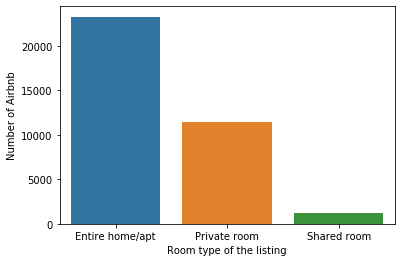

In [89]:
## Doing a countplot on room_type column to find out which is the most preferred type
room_plot = sns.countplot(df_Fact2['room_type'])
room_plot.set(xlabel='Room type of the listing', ylabel='Number of Airbnb')
plt.show()

##### <font color='blue'> Finding out the top 5 neighbhourhoods for Airbnb listings 

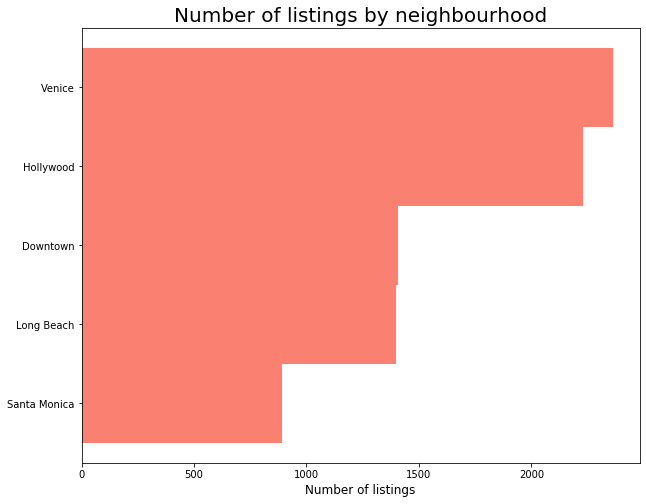

In [90]:
## Plotting a bar graph here 
feq=df_Fact2['neighbourhood_cleansed'].value_counts().nlargest(5).\
    sort_values(ascending=True)
feq.plot.barh(figsize=(10, 8), color='salmon', width=1)
plt.title("Number of listings by neighbourhood", fontsize=20)
plt.xlabel('Number of listings', fontsize=12)
plt.show()

##### <font color='blue'> Now, lets see what type of property are most common 

In [91]:
df_Fact2.property_type.value_counts()

Apartment                13206
House                    12067
Guesthouse                2186
Condominium               1965
Guest suite               1375
Townhouse                 1137
Bungalow                  1106
Loft                       842
Villa                      609
Hostel                     236
Serviced apartment         231
Cottage                    176
Bed and breakfast          160
Camper/RV                  133
Other                       97
Boutique hotel              82
Tiny house                  68
Cabin                       67
Hotel                       37
Aparthotel                  35
Farm stay                   23
Tent                        20
Castle                      16
Boat                        15
Chalet                      13
Treehouse                   10
Tipi                         7
Yurt                         7
Barn                         5
Earth house                  5
Dome house                   3
Dorm                         3
Campsite

##### <font color='blue'> We have a lot of similar kind of properties therefore clubbing them into one category 

In [92]:
## Converting other apartment type listings to Apartment 
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Serviced apartment'] = 'Apartment'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Aparthotel'] = 'Apartment'

## Converting other house type listings to House 
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Villa'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Cottage'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Bungalow'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Tiny house'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Chalet'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Farm stay'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Cabin'] = 'House'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Dome house'] = 'House'

## Converting other guesthouse type listings to Guesthouse 
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Guest suite'] = 'Guesthouse'

## Converting other guesthouse type listings to Hotel
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Boutique hotel'] = 'Hotel'
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Bed and breakfast'] = 'Hotel'

## Converting other hostel type listings to Hostel
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Dorm'] = 'Hostel'

## Converting other hostel type listings to Hostel
df_Fact2.property_type.loc[df_Fact2.property_type.values=='Campsite'] = 'Camper/RV'


top5types = df_Fact2.property_type.value_counts().nlargest(5).index

df_Fact2.property_type.value_counts()

House                    14132
Apartment                13472
Guesthouse                3561
Condominium               1965
Townhouse                 1137
Loft                       842
Hotel                      279
Hostel                     239
Camper/RV                  136
Other                       97
Tent                        20
Castle                      16
Boat                        15
Treehouse                   10
Tipi                         7
Yurt                         7
Earth house                  5
Barn                         5
Houseboat                    3
Hut                          2
Bus                          2
Lighthouse                   1
Igloo                        1
Resort                       1
Pension (South Korea)        1
Island                       1
Train                        1
Minsu (Taiwan)               1
Name: property_type, dtype: int64

##### <font color='blue'>Taking the top 5 types of Airbnb properties 

In [93]:
top5types

Index(['House', 'Apartment', 'Guesthouse', 'Condominium', 'Townhouse'], dtype='object')

##### <font color='blue'>Setting non-top properties as Other to differentiate better

In [94]:
df_Fact2.loc[~df_Fact2.property_type.isin(top5types),'property_type'] = 'Other'
df_Fact2.property_type.value_counts()

House          14132
Apartment      13472
Guesthouse      3561
Condominium     1965
Other           1692
Townhouse       1137
Name: property_type, dtype: int64

##### <font color='blue'> Understanding what kind of properties are famous in the top 5 neighbhourhoods

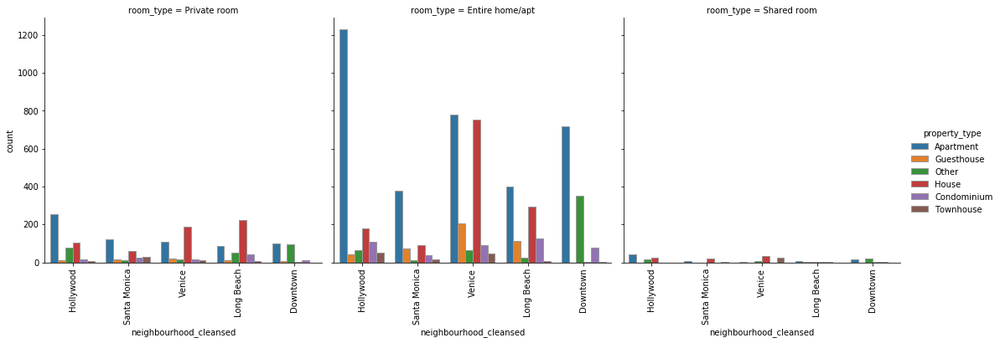

In [95]:
#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica'])]

#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='room_type', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)


###### <div class="alert alert-block alert-info"> We can see that Apartment style listings are highest in number in all the neighbhourhoods.As we can see, Hollywood has the highest number of apartment style listings. In Venice, we observe that both Apartment and House styled listings are highest. In Downtown we also observe that Other type of listings like tent, camper/RV etc are popular.    

#### <font color='blue'> Grouping the top 5 property types with the number of reviews

In [96]:
df_Fact2.groupby('property_type')['number_of_reviews'].count().nlargest(5)

property_type
House          14132
Apartment      13472
Guesthouse      3561
Condominium     1965
Other           1692
Name: number_of_reviews, dtype: int64

In [97]:
df_Fact2.dtypes

name                            object
property_type                   object
room_type                       object
neighbourhood_cleansed          object
review_scores_rating           float64
review_scores_accuracy         float64
review_scores_cleanliness      float64
review_scores_checkin          float64
review_scores_communication    float64
review_scores_location         float64
review_scores_value            float64
number_of_reviews                int64
first_review                    object
last_review                     object
minimum_nights                   int64
price                           object
reviews_per_month              float64
host_response_time              object
cancellation_policy             object
dtype: object

In [98]:
property_col = df_Fact2.property_type.value_counts().nlargest(5)

##### <font color='blue'> Top 5 property types by the number of reviews

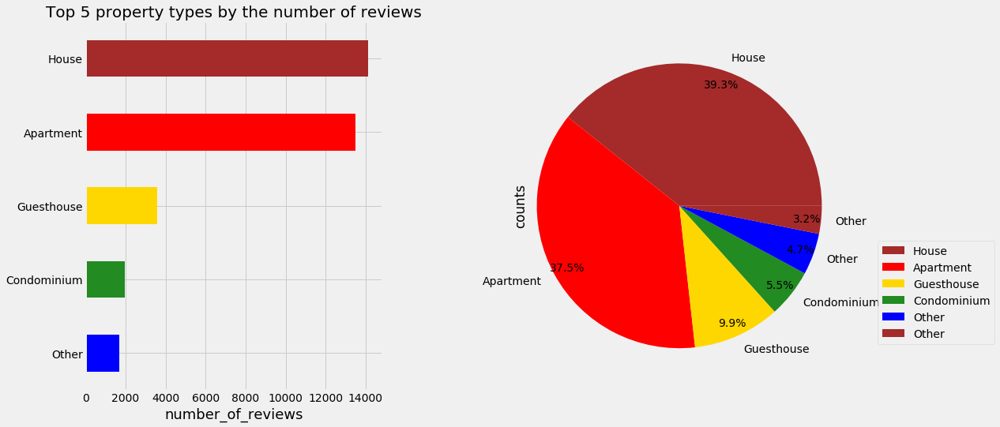

In [99]:
plt.style.use('fivethirtyeight')

## Setting the subplots and color for the piechart and barplot
fig,ax=plt.subplots(1,2,figsize=(15,8))
clr = ("blue", "forestgreen", "gold", "red", "brown")

## Plotting a bar plot to get the top 5 property_type values 
df_Fact2.property_type.value_counts().sort_values(ascending=False)[:5].\
sort_values().plot(kind='barh',color=clr,ax=ax[0])

## Settting the x axis and title 
ax[0].set_title("Top 5 property types by the number of reviews",size=20)
ax[0].set_xlabel('number_of_reviews',size=18)

## Doing a count and grouping the property_type for the top 5
count=df_Fact2['property_type'].value_counts()
groups=list(df_Fact2['property_type'].value_counts().index)[:5]
counts=list(count[:5])
counts.append(count.agg(sum)-count[:5].agg('sum'))
groups.append('Other')
type_dict=pd.DataFrame({"group":groups,"counts":counts})

clr1=("brown","red", "gold", "forestgreen","blue")
qx = type_dict.plot(kind='pie', y='counts', labels=groups,colors=clr1,\
                    autopct='%1.1f%%', pctdistance=0.9, radius=1.2,ax=ax[1])

plt.legend(loc=0, bbox_to_anchor=(1.15,0.4)) 
plt.subplots_adjust(wspace =0.5, hspace =0)
plt.ioff()

##### <font color='blue'> Specific type of reviews which people look at when booking an airbnb

In [100]:
df_Fact2.review_scores_accuracy.count()

35367

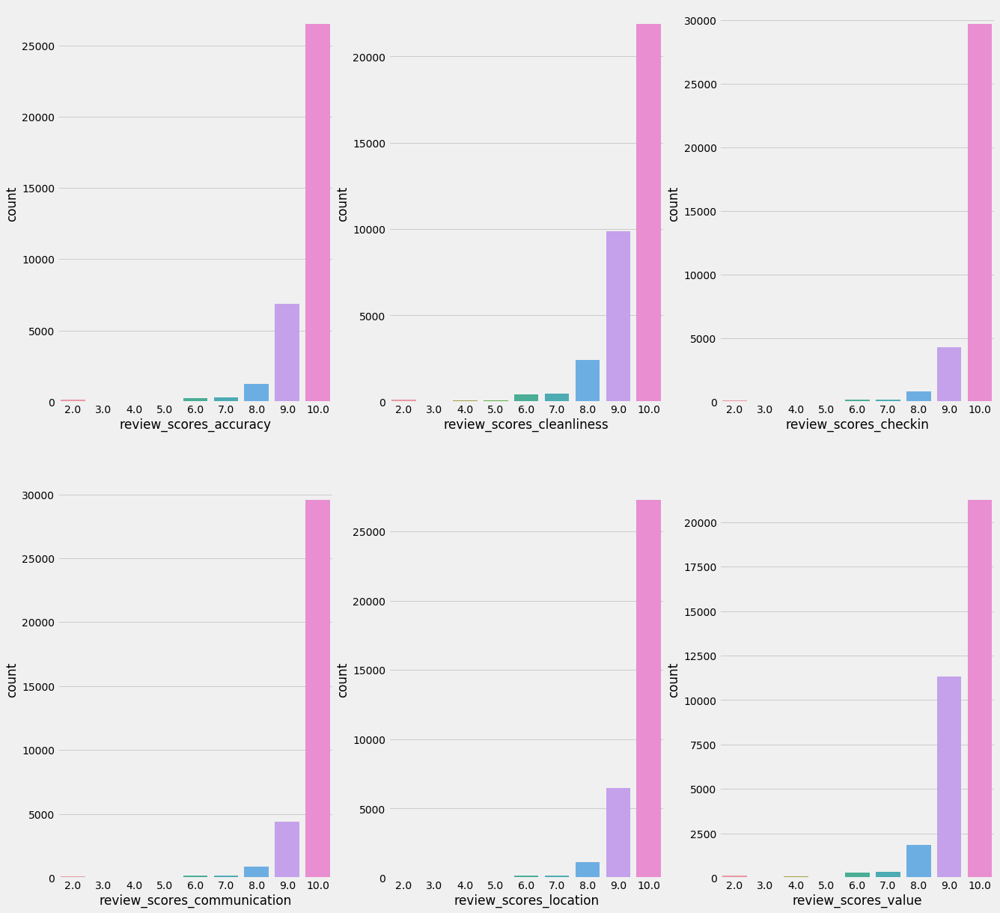

In [102]:
## Making sublplots to plot the countplots 
fig,axes= plt.subplots(nrows=2, ncols= 3,figsize=(20,20))

## Customer review count on the basis of accuracy

sns.countplot(df_Fact2['review_scores_accuracy'],ax=axes[0][0])        

## Customer review count on the basis of cleanliness
sns.countplot(df_Fact2['review_scores_cleanliness'],ax=axes[0][1])

## Customer review count on the basis of checkin
sns.countplot(df_Fact2['review_scores_checkin'],ax=axes[0][2])

## Customer review count on the basis of communication
sns.countplot(df_Fact2['review_scores_communication'],ax=axes[1][0])

## Customer review count on the basis of location
sns.countplot(df_Fact2['review_scores_location'],ax=axes[1][1])

## Customer review count on the basis of value
sns.countplot(df_Fact2['review_scores_value'],ax=axes[1][2])


###### <div class="alert alert-block alert-info"> As observed customers who have good Airbnb experience have reviewed their stay 8.0 or above. Lets take a closer look at how the top 5 neighbhourhoods are rated in these high scores.

##### <font color='blue'> Understanding the customer reviews at the top 5 neighbourhoods against the property type

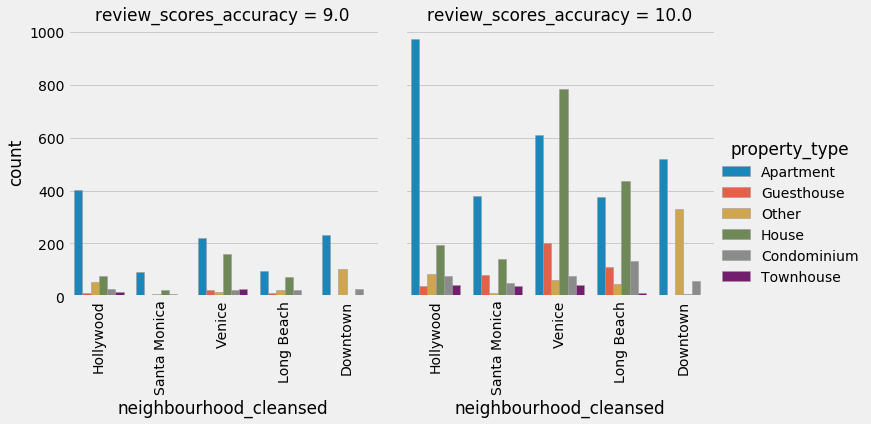

In [105]:
## Checking for review_scores_accuracy
df_Fact2.groupby('neighbourhood_cleansed')['review_scores_accuracy'].value_counts().nlargest(5)

#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[(df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica']))&(df_Fact2.review_scores_accuracy.isin(['9.0','10.0']))]
                                                                          
                                                                          
#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='review_scores_accuracy', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)

plt.show()

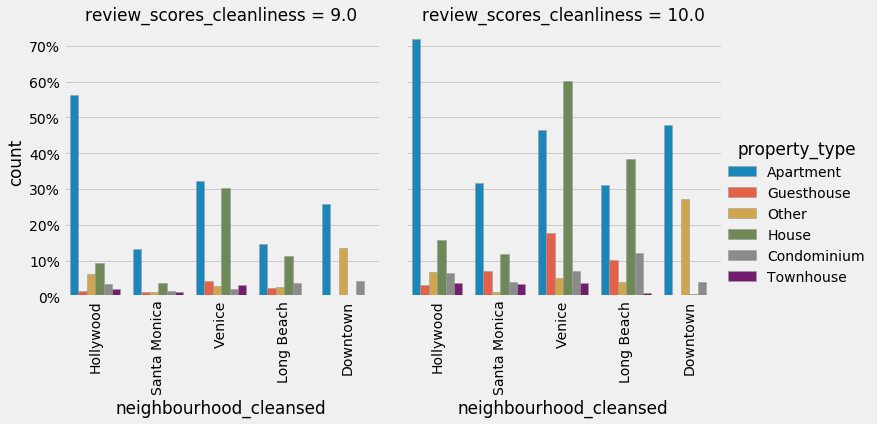

In [106]:
df_Fact2.groupby('neighbourhood_cleansed')['review_scores_cleanliness'].value_counts().nlargest(5)

#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[(df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica']))&(df_Fact2.review_scores_cleanliness.isin(['9.0'\
                                                                            ,'10.0']))]

#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='review_scores_cleanliness', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)

for ax in viz.axes.flat:
    ax.yaxis.set_major_formatter(PercentFormatter(1000))
plt.show()

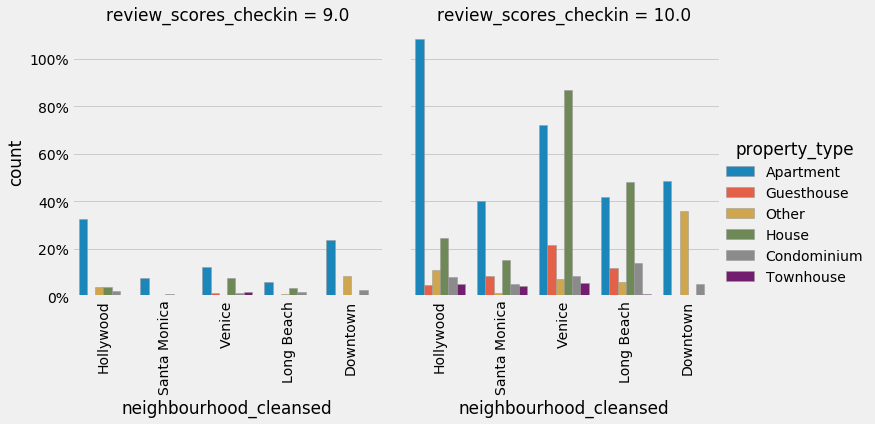

In [107]:
df_Fact2.groupby('neighbourhood_cleansed')['review_scores_checkin'].value_counts().nlargest(5)

#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[(df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica']))&(df_Fact2.review_scores_checkin.isin(['9.0'\
                                                                            ,'10.0']))]

#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='review_scores_checkin', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)

for ax in viz.axes.flat:
    ax.yaxis.set_major_formatter(PercentFormatter(1000))
plt.show()

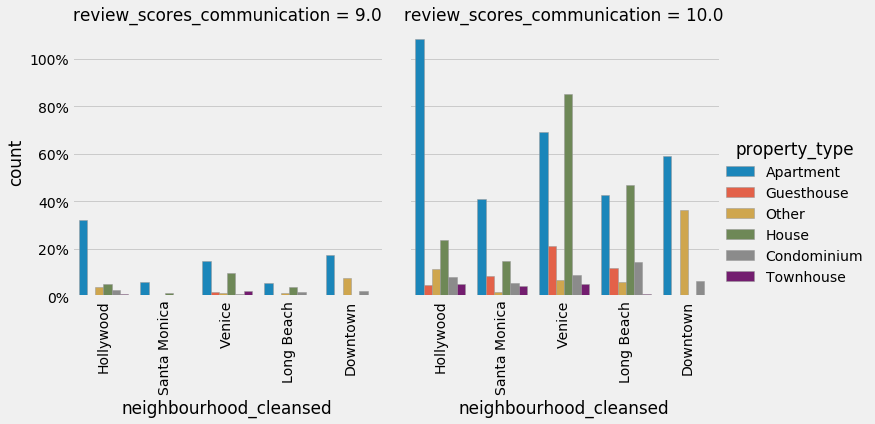

In [108]:
df_Fact2.groupby('neighbourhood_cleansed')['review_scores_communication'].value_counts().nlargest(5)

#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[(df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica']))&(df_Fact2.review_scores_communication.isin(['9.0'\
                                                                            ,'10.0']))]

#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='review_scores_communication', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)

for ax in viz.axes.flat:
    ax.yaxis.set_major_formatter(PercentFormatter(1000))
plt.show()

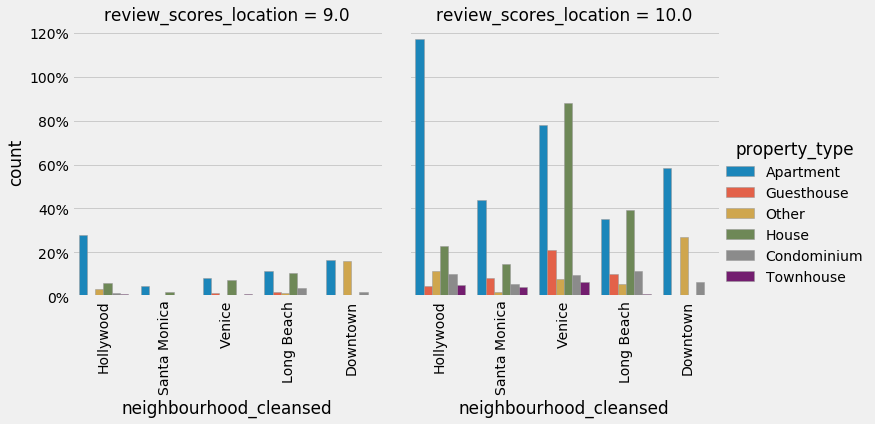

In [109]:
df_Fact2.groupby('neighbourhood_cleansed')['review_scores_location'].value_counts().nlargest(5)

#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[(df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica']))&(df_Fact2.review_scores_location.isin(['9.0'\
                                                                            ,'10.0']))]

#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='review_scores_location', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)
for ax in viz.axes.flat:
    ax.yaxis.set_major_formatter(PercentFormatter(1000))
plt.show()

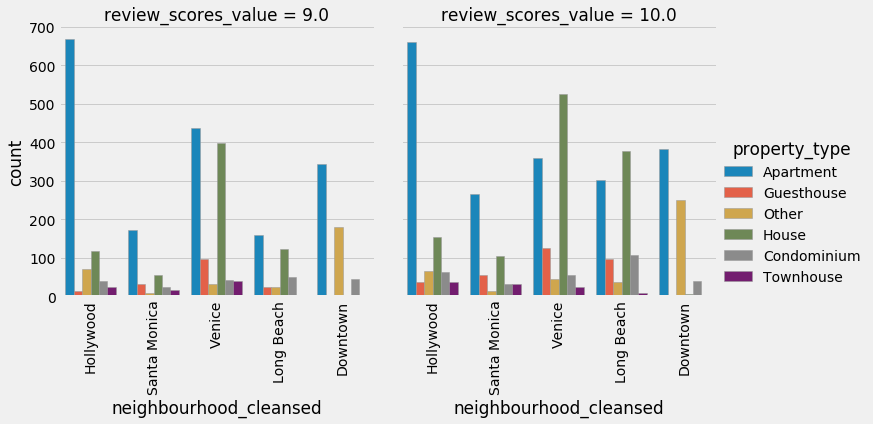

In [110]:
df_Fact2.groupby('neighbourhood_cleansed')['review_scores_value'].value_counts().nlargest(5)

#grabbing top 5 neighbourhoods for sub-dataframe
sub_5=df_Fact2.loc[(df_Fact2['neighbourhood_cleansed'].\
                 isin(['Venice','Hollywood','Downtown','Long Beach',
                 'Santa Monica']))&(df_Fact2.review_scores_value.isin(['9.0'\
                                                                            ,'10.0']))]

#using catplot to represent multiple interesting attributes together and a count
viz=sns.catplot(x='neighbourhood_cleansed',\
                  col='review_scores_value', data=sub_5,\
                   kind='count',hue='property_type',edgecolor=".6")
viz.set_xticklabels(rotation=90)

###### <div class="alert alert-block alert-info">We see that for a perfect score of 10.0 in the categories- accuracy,cleanliness,checkin,communication,location and value:<br><li>Hollywood has the highest cutomer ratings for Apartment style listings.</li><br><li>It is interesting to see that in Venice & Long Beach - House type listings have higher customer ratings overall in contrast to Apartment style listings.</li><br><li> Overall for the category of value, Hollywood apartments, Venice & Long Beach's houses are customer's favorite. Even the Downtown region has notiecable preference for apartment styled listings.<br><br><li> It is also observed that in Downtown customers have varied property type experience as the "Other" category in property_type which includes tent, bus,camper/RV etc, has been scored high.</li>  
    

### <font color='red'> Interesting Fact 3

#### <font color='green'>Q) Make a dataset copy for Interesting Fact 3 which is focused on:
<font color='green'> Predicting where and what kind of listing a Host should invest in for a profitable Airbnb business.
</font>

###### <div class="alert alert-block alert-success"><li>Using a decision tree class model we have come to a conclusion that the important features for the first prediction model are the priceRange,Santa monica neighbhourhood and the guests_included.</li><br><li>This prediction model focusing on the relationship of priceRange with neighbhourhood and price around guests covered in the price has about 67% accuracy.</li><br><li> Moreover, we have also made another prediction model to find out if the customer reviews have a potential impact on the room_type of host listings.The listing's 365 availability, room_type and long beaach neighbhourhood are the most important features for the 2nd prediction model.</li><br><li>The accuracy of the 2nd prediction model is better than the 1st model : 77%.</li><br><li> From both the classifcation models we see that the host can look the priceRange and room_type predictions to potentially decide on a profitable airbnb listing. 

In [111]:
#importing libraries for the decision tree classification model 
import sklearn as sk
import sklearn.tree as tree
from IPython.display import Image  
import pydotplus

In [112]:
## Taking a copy of the original file 
df_host = initFile.copy()

##### <font color='blue'> Cleaning the df_host dataset as we did for df_fact1 and df_Fact2 

In [114]:
### Taking only the CA listings and making sure everything in state as uppercase
df_host.state.loc[df_host.state=='California'] = 'CA'
df_host.state.unique()
df_host.state = df_host['state'].str.upper()

In [115]:
## Making sure we have only CA state values
df_host.drop(df_host[~(df_host.state.values=='CA')].index,axis=0,inplace=True)

In [116]:
df_host.city = df_host.city.str.lower()
df_host.city.unique()
df_host.city.dropna(inplace=True)

In [117]:
df_host['city'] = df_host['city'].str.replace(r'[^\x00-\x7F]+', '')
df_host.city.dropna(inplace=True)

##### <font color='blue'> Cleaning up all the location related columns 

In [118]:
## Removing the spaces from the neighbourhood_cleansed
df_host.neighbourhood_cleansed = df_host.neighbourhood_cleansed.str.strip()

## Cleaning the smart_location column 
df_host.smart_location = df_host.smart_location.str.replace(', ca',' ', regex=True)
df_host.smart_location = df_host.smart_location.str.strip()
df_host.drop(df_host[(df_host['smart_location'] == '蒙特利帕克, ca') | \
                       (df_host['smart_location'] == '因達斯特里, ca') | \
                       (df_host['smart_location'] == '艾尔蒙地, ca') | \
                       (df_host['smart_location'] == '沃尔纳特, ca') | \
                       (df_host['smart_location'] == '哈仙达岗, ca') | \
                       (df_host['smart_location'] == '罗兰高地, ca') | \
                       (df_host['smart_location'] == '罗兰岗, ca') | \
                       (df_host['smart_location'] == '天普市, ca') | \
                       (df_host['smart_location'] == '洛杉矶, ca')  \
                      ].index, inplace = True)

## Convert smart_location and neighbourhood_cleansed columns into lower case
df_host.smart_location = df_host.smart_location.str.lower()
df_host.neighbourhood_cleansed = df_host.neighbourhood_cleansed.str.lower() 

##### <font color='blue'> Cleaning the listing price related columns 

In [119]:
## Removing the '$' & ',' symbols form the security_deposit column 
df_host.security_deposit = df_host.security_deposit.str.strip('$')
df_host.security_deposit = df_host.security_deposit.str.replace(',','')

## Converting the security_deposit column to Float from str
df_host.security_deposit = df_host.security_deposit.astype('float64')

## Rounding the security_deposit column values after filling the NaN values to mean() of
## the security_deposit values
df_host.security_deposit.fillna(round(df_host.security_deposit.mean(),2),inplace=True)

## Removing the '$' & ',' symbols form the cleaning_fee column 
df_host.cleaning_fee = df_host.cleaning_fee.str.strip('$')
df_host.cleaning_fee = df_host.cleaning_fee.str.replace(',','')

## Converting the cleaning_fee column to Float from str
df_host.cleaning_fee = df_host.cleaning_fee.astype('float64')

## Converting the cleaning_fee column NaN values to the mean() of values in that column
df_host.cleaning_fee.fillna(round(df_host.cleaning_fee.mean(),2),inplace=True)

## Removing the '$' & ',' symbols form the price column 
df_host.price = df_host.price.str.strip('$')
df_host.price = df_host.price.str.replace(',','')

## Converting the price column to Float from str
df_host.price = df_host.price.astype('float64')

## Price '0' makes no sense as the listing need to charge for per night stay and there are
## only 9 values 
df_host.drop(df_host[df_host.price==0].index,axis=0,inplace=True)

## Removing the '$' & ',' symbols form the extra_people column 
df_host.extra_people = df_host.extra_people.str.strip('$')
df_host.extra_people = df_host.extra_people.str.replace(',','')

## Converting the extra_people column to Float from str
df_host.extra_people = df_host.extra_people.astype('float64')


##### <font color='blue'> Cleaning the important columns we are considering off their NaN values

In [120]:
df_host.zipcode.dropna(inplace=True)

##### <font color='blue'> Making sure the columns related to df_Fact2 are also clean and uniform 

In [121]:
## Dropping the nan reviews from the number_of_Reviews column 
df_host.drop(df_host[df_host.number_of_reviews.values==0].index,axis=0,inplace=True)

## Converting other apartment type listings to Apartment 
df_host.property_type.loc[df_host.property_type.values=='Serviced apartment'] = 'Apartment'
df_host.property_type.loc[df_host.property_type.values=='Aparthotel'] = 'Apartment'

## Converting other house type listings to House 
df_host.property_type.loc[df_host.property_type.values=='Villa'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Cottage'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Bungalow'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Tiny house'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Chalet'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Farm stay'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Cabin'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Dome house'] = 'House'
df_host.property_type.loc[df_host.property_type.values=='Townhouse'] = 'House'

## Converting other guesthouse type listings to Guesthouse 
df_host.property_type.loc[df_host.property_type.values=='Guest suite'] = 'Guesthouse'

## Converting other guesthouse type listings to Hotel
df_host.property_type.loc[df_host.property_type.values=='Boutique hotel'] = 'Hotel'
df_host.property_type.loc[df_host.property_type.values=='Bed and breakfast'] = 'Hotel'

## Converting other hostel type listings to Hostel
df_host.property_type.loc[df_host.property_type.values=='Dorm'] = 'Hostel'

## Converting other hostel type listings to Hostel
df_host.property_type.loc[df_host.property_type.values=='Campsite'] = 'Camper/RV'

top5types = df_host.property_type.value_counts().nlargest(5).index

df_host.loc[~df_host.property_type.isin(top5types),'property_type'] = 'Other'

In [122]:
df_host.property_type.value_counts()

House          15262
Apartment      13470
Guesthouse      3558
Condominium     1965
Other            848
Loft             842
Name: property_type, dtype: int64

In [123]:
df_host['property_style'] = ''

In [125]:
df_host['property_style'].replace('', np.nan, inplace=True)

df_host.property_style.fillna(0,inplace=True)


##### <font color ='blue'> Created a new column "property_style" which has the following values and references:<br><ul><li>House -> 1</li><br><li>Apartment -> 2</li><br><li>Guesthouse -> 3</li><br><li>Condominium -> 4</li><br><li>Other -> 0</li></ul>

In [126]:
df_host.property_style.loc[df_host.property_type=='House'] = 1
df_host.property_style.loc[df_host.property_type=='Apartment'] = 2
df_host.property_style.loc[df_host.property_type=='Guesthouse'] = 3
df_host.property_style.loc[df_host.property_type=='Condominium'] = 4
df_host.property_style.loc[df_host.property_type=='Other'] = 0

In [127]:
df_host.property_style.value_counts()

1.0    15262
2.0    13470
3.0     3558
4.0     1965
0.0     1690
Name: property_style, dtype: int64

In [128]:
df_host['priceRange'] = ''

In [129]:
df_host.priceRange.loc[(df_host['price']> 9.999) & (df_host['price'] <= 110.0)] = 0#Low
df_host.priceRange.loc[(df_host['price'] > 110.0) & (df_host['price'] <= 500.0)] = 1#Mid
df_host.priceRange.loc[(df_host['price'] > 500.0) & (df_host['price'] <= 25000.0)] =2#High

##### <font color='blue'> Lets predict where a future airbnb host should invest in the top5 neighbhourhoods?

In [130]:
df_Fact = df_host[['property_style','priceRange',\
                   'guests_included','neighbourhood_cleansed']].copy()
df_Fact.reset_index()

,id,property_style,priceRange,guests_included,neighbourhood_cleansed
0,1,4.0,1,3,culver city
1,2,1.0,1,6,burbank
2,3,2.0,0,1,hollywood
3,4,2.0,1,1,santa monica
4,6,1.0,0,1,del rey
...,...,...,...,...,...
35940,44449,0.0,1,1,koreatown
35941,44451,0.0,0,1,koreatown
35942,44512,2.0,0,1,westwood
35943,44539,2.0,0,2,pasadena


##### <font color='blue'>Creating a new dataframe which is specific to the top 5 neighbourhoods

In [138]:
df_Fact3  = df_Fact.loc[(df_Fact['neighbourhood_cleansed'].\
                 isin(['venice','hollywood','downtown','long beach',
                 'santa monica']))].copy()
df_Fact3.head()

,property_style,priceRange,guests_included,neighbourhood_cleansed
id,,,,
3,2.0,0,1,hollywood
4,2.0,1,1,santa monica
10,2.0,0,1,hollywood
14,3.0,1,1,venice
15,0.0,0,1,long beach


In [139]:
## Resetting the index to start from 0 
df_Fact3.reset_index(inplace=True)
df_Fact3.head(1)

,id,property_style,priceRange,guests_included,neighbourhood_cleansed
0,3,2.0,0,1,hollywood


In [140]:
df_Fact3.drop('id',axis=1,inplace=True) ## Dropping the old id column 

In [141]:
df_Fact3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8283 entries, 0 to 8282
Data columns (total 4 columns):
property_style            8283 non-null float64
priceRange                8283 non-null int64
guests_included           8283 non-null int64
neighbourhood_cleansed    8283 non-null object
dtypes: float64(1), int64(2), object(1)
memory usage: 259.0+ KB


##### <font color='blue'> df_dt1 referes to the first decision tree model dataframe. This model will be focusing on predicting what priceRange the host can potentially charge based on its dependency on the dataset columns like neighbourhood, property_style and guests_included

In [143]:
df_dt1 = pd.get_dummies(df_Fact3, columns=['neighbourhood_cleansed'])
df_dt1.head(3)

,property_style,priceRange,guests_included,neighbourhood_cleansed_downtown,neighbourhood_cleansed_hollywood,neighbourhood_cleansed_long beach,neighbourhood_cleansed_santa monica,neighbourhood_cleansed_venice
0,2.0,0,1,0,1,0,0,0
1,2.0,1,1,0,0,0,1,0
2,2.0,0,1,0,1,0,0,0


In [146]:
## Creating a dataframe including the independent variables except the dependent variable
X1 = df_dt1.drop(['priceRange'],axis=1)

In [147]:
## Creating the dependent variable with the neighbourhood_cleansed column. Y is a series.
Y1 = df_dt1.priceRange    

In [148]:
## Splitting the data into train and test data for the decision tree model
from sklearn.model_selection import train_test_split

## Here, we are dividing the data into 70% train and 30% test data
X1_train, X1_test, Y1_train, Y1_test = train_test_split\
(X1, Y1, test_size=0.3, random_state = 0)

In [149]:
X1_train.head()

,property_style,guests_included,neighbourhood_cleansed_downtown,neighbourhood_cleansed_hollywood,neighbourhood_cleansed_long beach,neighbourhood_cleansed_santa monica,neighbourhood_cleansed_venice
3663,1.0,2,0,0,0,0,1
7462,2.0,1,0,0,0,0,1
1465,1.0,2,0,1,0,0,0
1371,2.0,1,0,0,0,0,1
2500,2.0,3,1,0,0,0,0


In [150]:
X1_test.head()

,property_style,guests_included,neighbourhood_cleansed_downtown,neighbourhood_cleansed_hollywood,neighbourhood_cleansed_long beach,neighbourhood_cleansed_santa monica,neighbourhood_cleansed_venice
196,1.0,1,0,0,1,0,0
1523,2.0,2,0,0,0,0,1
3990,4.0,1,0,0,1,0,0
2385,2.0,1,0,1,0,0,0
5655,0.0,1,1,0,0,0,0


In [151]:
## Defining the decision tree classifier to maximum depth of 3
dt1 = tree.DecisionTreeClassifier(max_depth=3) 

In [152]:
#Fitting the model 
dt1.fit(X1_train,Y1_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

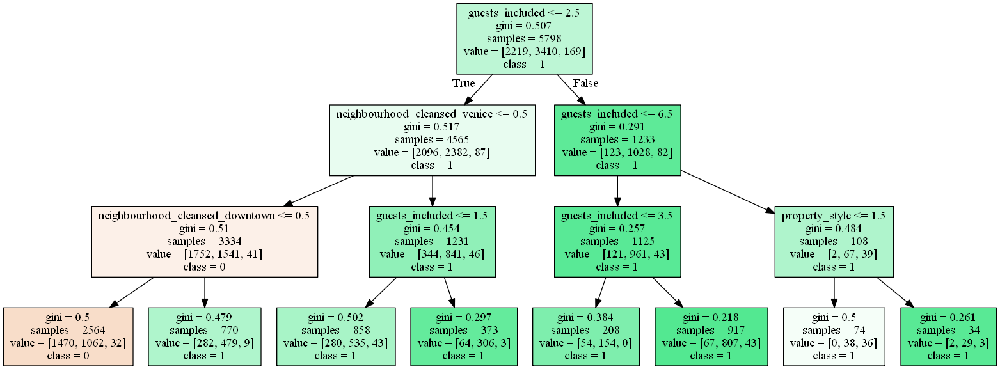

In [156]:
# This code will visualize a decision tree dt, trained with the attributes in X and the class labels in Y
dt1_feature_names = list(X1.columns) #Converting the independent variables to a list 
dt1_target_names = [str(s) for s in Y1.unique()] #take unique values of Y i.e. DogName
tree.export_graphviz(dt1, out_file='tree.dot', 
    feature_names=dt1_feature_names, class_names=dt1_target_names,
    filled=True)  
graph = pydotplus.graph_from_dot_file('tree.dot') #generating a tree
Image(graph.create_png())

##### <font color='blue'> Understanding the important features for the model 

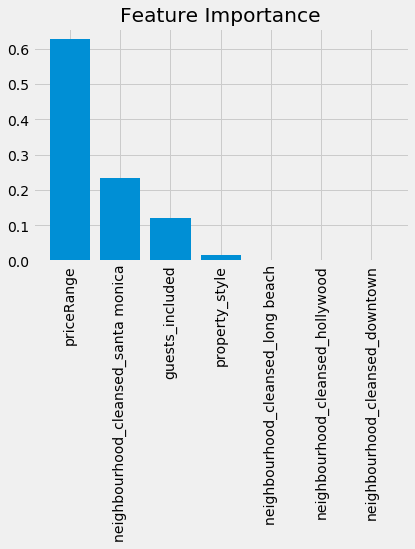

In [157]:
importances1 = dt1.feature_importances_

# Sort feature importances in descending order
indices = np.argsort(importances1)[::-1]

# Rearrange feature names so they match the sorted feature importances
names = [df_dt1.columns[i] for i in indices]

# Create plot
plt.figure()

# Create plot title
plt.title("Feature Importance")

# Add bars
plt.bar(range(X1.shape[1]), importances1[indices])

# Add feature names as x-axis labels
plt.xticks(range(X1.shape[1]), names, rotation=90)

# Show plot
plt.show()

##### <font color='blue'> Predicting on the test dataset

In [159]:
dt1.predict(X1_test)

array([0, 1, 0, ..., 1, 1, 0], dtype=int64)

##### <font color='blue'> Accuracy of the prediction model 

In [170]:
acc_dt1 = round((dt1.predict(X1_test) == Y1_test).mean()*100,2)
print('The accuracy of the first prediction model is:',\
     acc_dt1,'%')

The accuracy of the first prediction model is: 67.12 %


In [175]:
y1_pred = dt1.predict(X1_test)

##### <font color='blue'> Prediction output probability

In [ ]:
dt1.predict_proba(X1_test)

In [177]:
dt1.predict_proba(X1_test)[:,1]

array([0.41419657, 0.82037534, 0.41419657, ..., 0.62354312, 0.82037534,
       0.41419657])

In [178]:
y1_pred_proba = dt1.predict_proba(X1_test)[:,1]

##### <font color='blue'>Creating a confusion matrix to understand the True positives and True negatives 

In [179]:
from sklearn.metrics import confusion_matrix
import sklearn.metrics as met

In [180]:
confusion_matrix(Y1_test,y1_pred)

array([[ 634,  319,    0],
       [ 426, 1034,    0],
       [  12,   60,    0]], dtype=int64)

In [181]:
met.accuracy_score(Y1_test, y1_pred)

0.6712273641851106

##### <font color='blue'> Making a new dataframe which aims to understand and predict the possible relationship between the room_type and columns like price, neighbourhood, minimum_nights, reviews_per_month and availability_of_365

In [183]:
df_new = df_host[['room_type','price','neighbourhood_cleansed',\
                  'minimum_nights',\
                  'number_of_reviews',\
              'reviews_per_month','availability_365']].copy()

In [185]:
## Dividing the price into numerical encoded range values in a new col
df_new['priceRange'] = ''

In [187]:
df_new.priceRange.loc[(df_new['price']> 9.999) & (df_host['price'] <= 110.0)] = 0#Low
df_new.priceRange.loc[(df_new['price'] > 110.0) & (df_host['price'] <= 500.0)] = 1#Mid
df_new.priceRange.loc[(df_new['price'] > 500.0) & (df_host['price'] <= 25000.0)] =2#High

In [188]:
## Dropping the price column as its relevance has been reflected in the 
## priceRange column
df_new.drop(columns=['price'],axis=1,inplace=True)

##### <font color='blue'>Checking for NaN values in the columns of df_new dataframe

In [189]:
df_new.room_type.isna().sum()

0

In [190]:
df_new.minimum_nights.isna().sum()

0

In [191]:
df_new.availability_365.value_counts()

0      5835
365    1008
364     337
342     290
89      285
       ... 
203      19
202      19
208      17
194      16
200      15
Name: availability_365, Length: 366, dtype: int64

In [192]:
df_new.head()

,room_type,neighbourhood_cleansed,minimum_nights,number_of_reviews,reviews_per_month,availability_365,priceRange
id,,,,,,,
1,Entire home/apt,culver city,30,2,0.02,98,1
2,Entire home/apt,burbank,2,6,0.16,0,1
3,Private room,hollywood,28,20,0.32,238,0
4,Private room,santa monica,1,18,0.18,309,1
6,Private room,del rey,1,262,2.16,118,0


In [193]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 35945 entries, 1 to 44579
Data columns (total 7 columns):
room_type                 35945 non-null object
neighbourhood_cleansed    35945 non-null object
minimum_nights            35945 non-null int64
number_of_reviews         35945 non-null int64
reviews_per_month         35945 non-null float64
availability_365          35945 non-null int64
priceRange                35945 non-null int64
dtypes: float64(1), int64(4), object(2)
memory usage: 2.2+ MB


##### <font color='blue'> df_Fact3_2 is a dataframe for 2nd prediction model, this model also focuses on the top 5 neighbourhood's 

In [194]:
df_Fact3_2 = df_new.loc[(df_new['neighbourhood_cleansed'].\
                 isin(['venice','hollywood','downtown','long beach',
                 'santa monica']))].copy()
df_Fact3_2.head()

,room_type,neighbourhood_cleansed,minimum_nights,number_of_reviews,reviews_per_month,availability_365,priceRange
id,,,,,,,
3,Private room,hollywood,28,20,0.32,238,0
4,Private room,santa monica,1,18,0.18,309,1
10,Private room,hollywood,28,16,0.13,278,0
14,Entire home/apt,venice,3,382,3.26,335,1
15,Private room,long beach,2,380,4.90,79,0


##### <font color='blue'> Understanding the correlation betweeen the columns for 2nd model

In [195]:
df_Fact3_2.corr()

,minimum_nights,number_of_reviews,reviews_per_month,availability_365,priceRange
minimum_nights,1.000000,-0.111958,-0.209450,0.077473,0.012349
number_of_reviews,-0.111958,1.000000,0.571323,0.084578,-0.051838
reviews_per_month,-0.209450,0.571323,1.000000,0.014780,-0.085670
availability_365,0.077473,0.084578,0.014780,1.000000,0.097551
priceRange,0.012349,-0.051838,-0.085670,0.097551,1.000000


##### <font color='blue'> Creating dummies for neighbourhood column 

In [197]:
df_dt2 = pd.get_dummies(df_Fact3_2, columns=['neighbourhood_cleansed'])
df_dt2.head(3)

,room_type,minimum_nights,number_of_reviews,reviews_per_month,availability_365,priceRange,neighbourhood_cleansed_downtown,neighbourhood_cleansed_hollywood,neighbourhood_cleansed_long beach,neighbourhood_cleansed_santa monica,neighbourhood_cleansed_venice
id,,,,,,,,,,,
3,Private room,28,20,0.32,238,0,0,1,0,0,0
4,Private room,1,18,0.18,309,1,0,0,0,1,0
10,Private room,28,16,0.13,278,0,0,1,0,0,0


In [198]:
## Creating a dataframe including the independent variables except the dependent variable
X2 = df_dt2.drop(['room_type'],axis=1)

In [199]:
## Creating the dependent variable with the neighbourhood_cleansed column. Y is a series.
Y2 = df_dt2.room_type    

In [200]:
## Splitting the data into train and test data for the decision tree model
from sklearn.model_selection import train_test_split

## Here, we are dividing the data into 70% train and 30% test data
X2_train, X2_test, Y2_train, Y2_test = train_test_split\
(X2, Y2, test_size=0.3, random_state = 0)

In [201]:
## Defining the decision tree classifier to maximum depth of 3
dt2 = tree.DecisionTreeClassifier(max_depth=3) 

In [202]:
#Fitting the model 
dt2.fit(X2_train,Y2_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

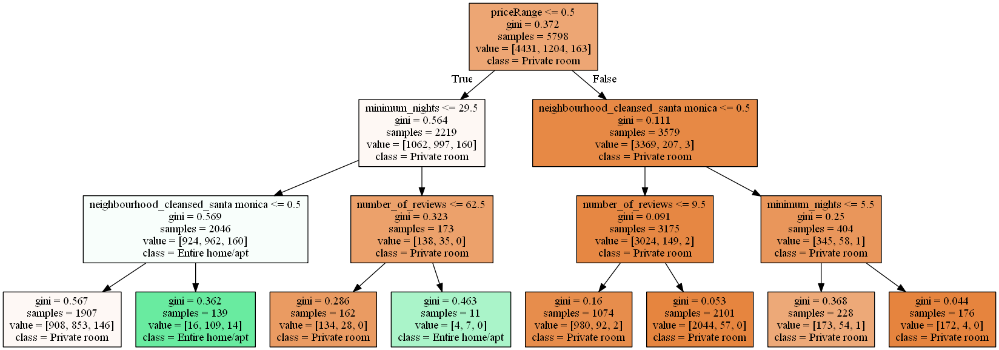

In [204]:
# This code will visualize a decision tree dt, trained with the attributes in X and the class labels in Y
dt2_feature_names = list(X2.columns) #Converting the independent variables to a list 
dt2_target_names = [str(s) for s in Y2.unique()] #take unique values of Y i.e. DogName
tree.export_graphviz(dt2, out_file='tree.dot', 
    feature_names=dt2_feature_names, class_names=dt2_target_names,
    filled=True)  
graph = pydotplus.graph_from_dot_file('tree.dot') #generating a tree
Image(graph.create_png())

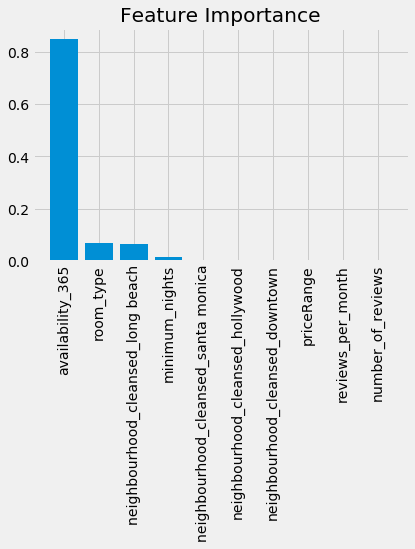

In [205]:
importances2 = dt2.feature_importances_

# Sort feature importances in descending order
indices = np.argsort(importances2)[::-1]

# Rearrange feature names so they match the sorted feature importances
names = [df_dt2.columns[i] for i in indices]

# Create plot
plt.figure()

# Create plot title
plt.title("Feature Importance")

# Add bars
plt.bar(range(X2.shape[1]), importances2[indices])

# Add feature names as x-axis labels
plt.xticks(range(X2.shape[1]), names, rotation=90)

# Show plot
plt.show()

##### <font color='blue'> Predicting on the test dataset

In [ ]:
dt2.predict(X2_test)

##### <font color='blue'> Calculating the accuracy of the 2nd model 

In [214]:
acc_dt2 = round((dt2.predict(X2_test) == Y2_test).mean()*100,2)
print('The accuracy of the 2nd prediction model is:',acc_dt2,'%')

The accuracy of the 2nd prediction model is: 77.83 %


In [209]:
y2_pred = dt2.predict(X2_test)

##### <font color='blue'> Prediction output probability

In [210]:
dt2.predict_proba(X2_test) 

array([[0.47614053, 0.44729942, 0.07656004],
       [0.47614053, 0.44729942, 0.07656004],
       [0.47614053, 0.44729942, 0.07656004],
       ...,
       [0.91247672, 0.08566108, 0.0018622 ],
       [0.97287006, 0.02712994, 0.        ],
       [0.82716049, 0.17283951, 0.        ]])

##### <font color='blue'> Confusion matrix 

In [211]:
from sklearn.metrics import confusion_matrix
import sklearn.metrics as met

In [212]:
confusion_matrix(Y2_test,y2_pred)

array([[1887,   10,    0],
       [ 471,   47,    0],
       [  59,   11,    0]], dtype=int64)